Nataly Chacón Buitrago

## Abstract


Convolutional Neural Networks (CNN) are a class of deep neural networks widely applied to analyzing images. Several authors have used this method to successfully classify microfossils, core images, petrographic photos, and rock and mineral hand sample images in the geosciences. We hypothesize that MobileNet (a pre-trained convolutional neural network) is helpful to classify sedimentary structures and reduce interpretation bias. We used 637 images of cross lamination, planar lamination, and ripples taken in the field from Nasa galleries and google images to train and test the CNN. The expert defined the labels (type of sedimentary structure) needed to train the algorithm and also monitored the result to address incorrect classification. The accuracy achieved of predicting sedimentary structures on new images using MobilNet was 82%. This tool could help identify sedimentary structures in the field without regarding the geologist's level of expertise or prior experience. 

## Introduction

In the geosciences Machine Learning (ML) techniques have been used in several applications such as seismic-facies classification (Roy et al.,2014), well-facies classification (Hall., 2010), analysis of seismicity (DeVries et al.,2018), microfossils classification (Pires de Lima.,2019), among others. Deep Learning (DL) is a subfield of ML that extracts information from the raw unstructured data. This method requires experts (in this case, an expert would be geologists who know how to identify sedimentary structures) to define the labels to construct the data set. The experts also identify any ambiguous data in the data set. For this project, 637 images were collected and labeled into three categories: cross lamination (label =0), planar lamination (label =1), and ripples (label = 2). 
In this paper, transfer learning using MobileNet was used. Mobilenet is a pre-trained convolutional neural network designed to effectively maximize accuracy while being mindful of the restricted resources. These convolutional neural networks are usually used for mobile applications.

## What is transfer learning?

Transfer learning is the process of using a pre-trained  model (in this case MobileNet)that has been trained on a dataset for training and predicting on a new given dataset. 

## About MobileNet

MobileNets are a class of lightweight deep convolutional neural networks that are vastly smaller in size and faster in performance than many other popular models LIKE VGG16; for example, however, there is a tradeoff. The tradeoff is accuracy, but don't let this discourage you. For this application, MobileNet worked very well!
<br>
MobileNet has 88 layers and 4,200,000 parameters. MobileNet was originally trained for fine-grained recognition on the Stanford Dog dataset (figure 1).

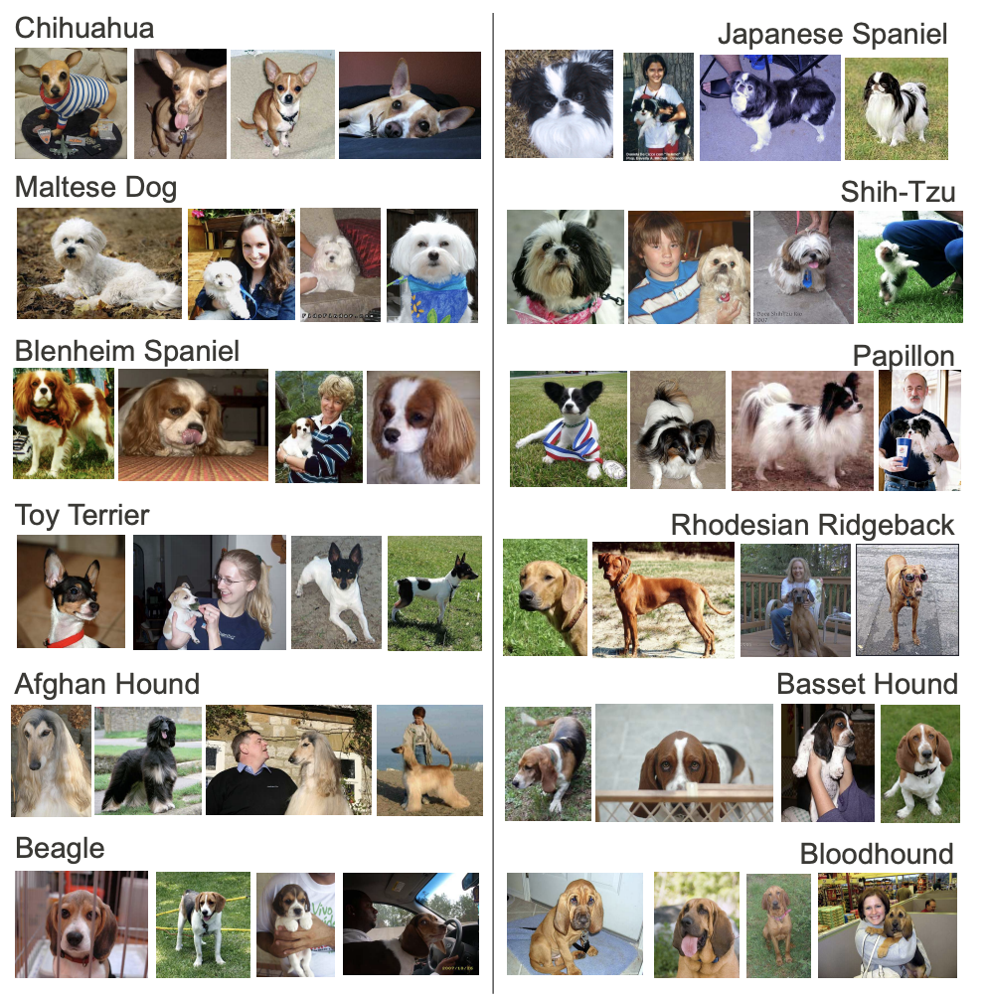

In [2]:
Image(filename ='/Users/nchaconb/Documents/Second_Semester/MLG/Final_Project/dogs_std.jpg', width = 400, height = 300)

Figure 1. Four random example images from 12 of the 120 dog categories used in the Stanford Dog dataset. Khosla et al. 2011.

Let's import all the packages that we will need!

In [1]:

import os
from IPython.display import Image
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from tensorflow.keras.applications import imagenet_utils
from sklearn.metrics import confusion_matrix
import itertools
import shutil
import random
import matplotlib.pyplot as plt

## Methodology

### Downloading Images and Data wrangling.

####  Collect images from personal gallery. 
(Special thanks to everyone who gave me images that improved my model: Zane Jobe, Mary Carr, Pengfei Hou,Thomas Martin, Daan Beelen,  Hanaga Simabrata,  Hannah Morgan)

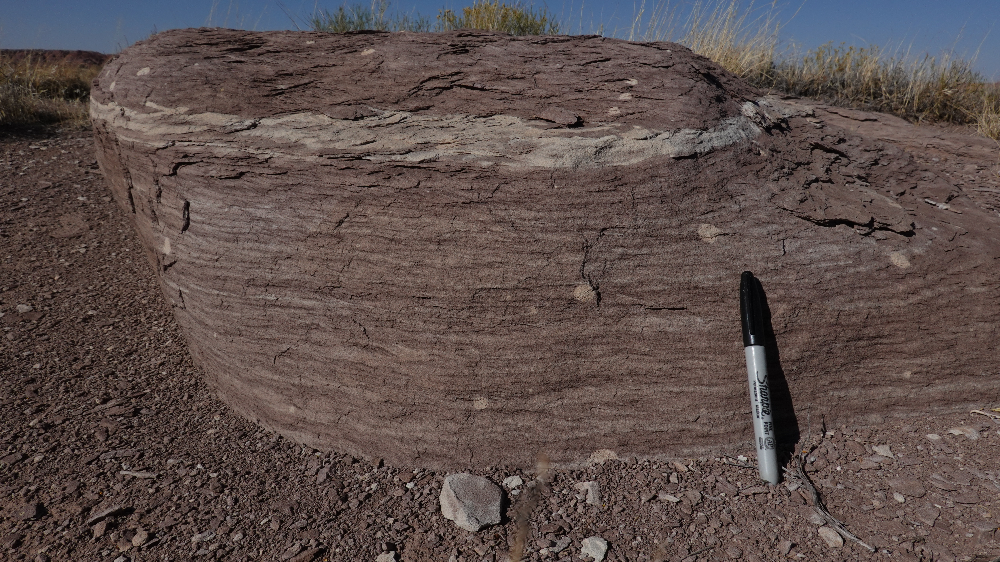

In [3]:
DATADIR = '/Users/nchaconb/Documents/Second_Semester/MLG/Final_Project/data'

Image(filename=os.path.join(DATADIR, '2/ZRJ00552.JPG'), width = 600, height = 300)

Figure 2. Ripples courtesy of Zane Jobe.

#### Collect images from Nasa's gallery

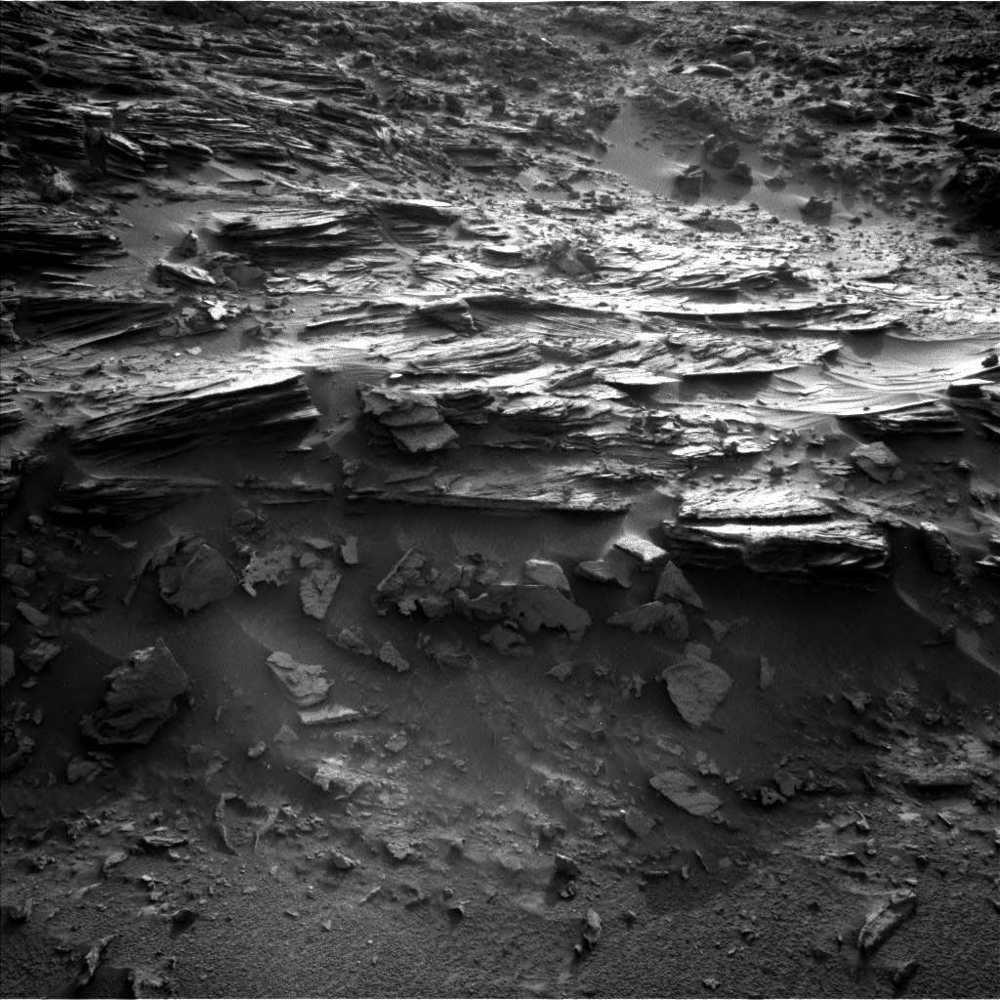

In [4]:
Image(filename=os.path.join(DATADIR, '0/NLB_490189395EDR_F0482200NCAM07752M_-br2.jpg'), width = 600, height = 300)

Figure 3. Figure of cross stratification in mars. Photo taken from Nasa's gallery.

#### Collect images from google.

In [5]:
#This code dowloads images from google images.

from simple_image_download import simple_image_download as simp

response = simp.simple_image_download

response().download('cross lamination', 100) # We changed the query for every category

[========================================================================] 100%


The collected images are grouped into three categories: ripples, planar lamination, and cross lamination. Some of the images are discarded by the expert because they are wrongly labeled.

### Image Preparation


In [6]:
#Organize the data into train,valid, test directories
os.chdir('/Users/nchaconb/Documents/MLG')

#First the data has to be in 3 folders label 0-2 
#make a train, valid and test directory
if os.path.isdir('train/0/')is False:
    os.mkdir('train')
    os.mkdir('valid')
    os.mkdir('test')
    
    for i in range(0,3):
        shutil.move(f'{i}','train')
        os.mkdir(f'valid/{i}')
        os.mkdir(f'test/{i}')
        
        valid_samples = random.sample(os.listdir(f'train/{i}'),30) #30 samples are moved to the validation set
        for j in valid_samples:
            shutil.move(f'train/{i}/{j}',f'valid/{i}')
            
        test_samples = random.sample(os.listdir(f'train/{i}'),5) # 5 samples are moved to the train set
        for k in test_samples:
            shutil.move(f'train/{i}/{k}',f'test/{i}')

os.chdir('../..')  

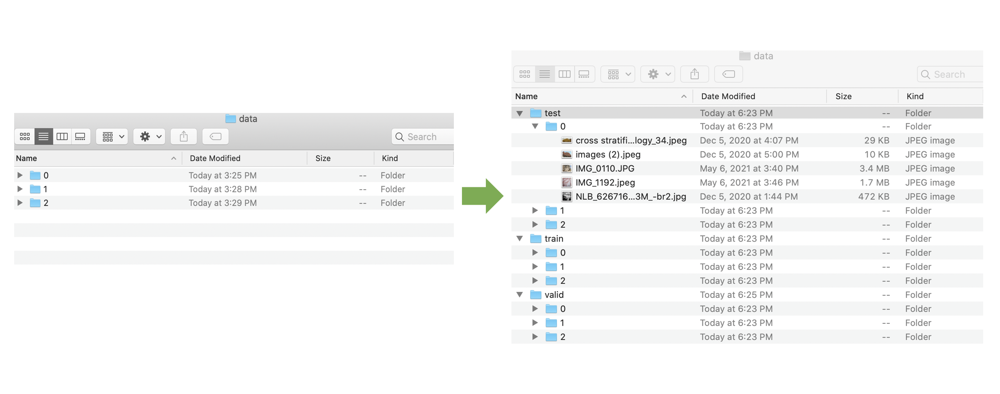

In [7]:
Image(filename=os.path.join('/Users/nchaconb/Documents/Second_Semester/MLG/Final_Project/antes_despues.jpg'), width = 800, height = 500)

Figure 4. The image on the left is the folders before the image preparation code above. We have 3 folders: 0 = cross-stratification, 1 = planar lamination, 2 = ripples. After the above code is run, we have three main folders: test, train, and valid each with subfolders 0,1 and 2.

In [8]:
train_path = '/Users/nchaconb/Documents/Second_Semester/MLG/Final_Project/data/train'
valid_path = '/Users/nchaconb/Documents/Second_Semester/MLG/Final_Project/data/valid'
test_path = '/Users/nchaconb/Documents/Second_Semester/MLG/Final_Project/data/test'

In [9]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=train_path, target_size=(224,224), batch_size=10)
valid_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=valid_path, target_size=(224,224), batch_size=10)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=test_path, target_size=(224,224), batch_size=10, shuffle=False)

Found 525 images belonging to 3 classes.
Found 89 images belonging to 3 classes.
Found 15 images belonging to 3 classes.


In [11]:
assert train_batches.n == 525
assert valid_batches.n == 89
assert test_batches.n == 15
assert train_batches.num_classes == valid_batches.num_classes == test_batches.num_classes == 3

##  Model 

In [12]:
#Dowload the mobile net
mobile = tf.keras.applications.mobilenet.MobileNet()

In [13]:
#Let's get a summary of the mobilenet!
mobile.summary()

Model: "mobilenet_1.00_224"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32)      128       
_________________________________________________________________
conv_dw_1_relu (ReLU)        (None, 112, 112, 32

## Modified Model (-40)

In [63]:
#For the Fine-Tuning I chose some layers from the original mobilnet
#The last 6 layers of MobileNet are not useful to train our data, so we erased them, you get this number by testing
x = mobile.layers[-6].output

#The output layer will have 3 units as we have 3 classes -> that is why we add a dense layer
#The X at the end tells the model that we want to exclude the last 6 layers 
output = Dense(units=3, activation = 'softmax')(x)

In [64]:
#Let's create the new model!
model = Model(inputs=mobile.input,outputs=output)

In [65]:
#Let's see a summary of the new fine tune model
model.summary()
#notice that we have an output layer with the possible 3 classes that our model has

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32)      128       
_________________________________________________________________
conv_dw_1_relu (ReLU)        (None, 112, 112, 32)      0   

In [66]:
#To improve the model we can freeze some layers 
#Let's freeze all except the last 40 layers 

for layer in model.layers[:-40]:
    layer.trainable= False

In [67]:
#Let's see a summary of the new fine tune model
model.summary()
#notice that we have an output layer with the possible 3 classes that our model has

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32)      128       
_________________________________________________________________
conv_dw_1_relu (ReLU)        (None, 112, 112, 32)      0   

## Training the Model (-40)

In [68]:
model.compile(optimizer=Adam(lr=0.0001),loss='categorical_crossentropy',metrics=['accuracy'])

In [74]:
history = model.fit(x=train_batches, validation_data=valid_batches, epochs=20,verbose=2)

Epoch 1/20
53/53 - 22s - loss: 4.5557e-04 - accuracy: 1.0000 - val_loss: 1.0449 - val_accuracy: 0.7753
Epoch 2/20
53/53 - 22s - loss: 9.1737e-05 - accuracy: 1.0000 - val_loss: 1.0127 - val_accuracy: 0.7865
Epoch 3/20
53/53 - 22s - loss: 1.9620e-04 - accuracy: 1.0000 - val_loss: 1.0018 - val_accuracy: 0.7865
Epoch 4/20
53/53 - 22s - loss: 0.0029 - accuracy: 0.9981 - val_loss: 2.2153 - val_accuracy: 0.6629
Epoch 5/20
53/53 - 23s - loss: 8.4232e-04 - accuracy: 1.0000 - val_loss: 1.8125 - val_accuracy: 0.6854
Epoch 6/20
53/53 - 23s - loss: 6.4228e-04 - accuracy: 1.0000 - val_loss: 1.1115 - val_accuracy: 0.7640
Epoch 7/20
53/53 - 24s - loss: 3.9235e-04 - accuracy: 1.0000 - val_loss: 1.0120 - val_accuracy: 0.7753
Epoch 8/20
53/53 - 22s - loss: 3.5199e-04 - accuracy: 1.0000 - val_loss: 0.9821 - val_accuracy: 0.7753
Epoch 9/20
53/53 - 22s - loss: 2.3551e-04 - accuracy: 1.0000 - val_loss: 0.9885 - val_accuracy: 0.7865
Epoch 10/20
53/53 - 22s - loss: 2.3242e-04 - accuracy: 1.0000 - val_loss: 0.9

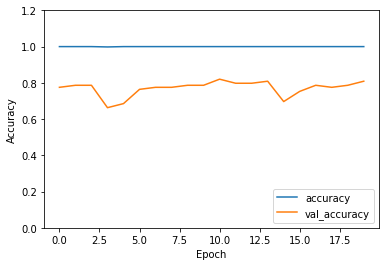

In [75]:
#We  got an accuracy of 99.24% and an val_accuracy of 0.81
#There is overfitting as the val_accuracy is more than the accuracy (More data could help with the overfitting?, 
                                                                    # freeze other layers could help)
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1.2])
plt.legend(loc='lower right')

Figure 5. Accuracy vs. Epoch showing how the accuracy and validation accuracy changes with the epoch when all layers are freeze except the last 40 layers.

## Predict Sedimentary Structures (-40)

In [76]:
test_labels = test_batches.classes
test_labels

array([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2], dtype=int32)

In [77]:
#make predictions with the train data set
predictions = model.predict(x=test_batches, verbose = 0)

In [78]:
cm = confusion_matrix(y_true=test_labels, y_pred=predictions.argmax(axis=1))

In [79]:
#verify the class indices test batches
test_batches.class_indices
#0 = cross stratification
#1 = planar lamination
#2 = ripples

{'0': 0, '1': 1, '2': 2}

In [80]:
#function for plotting confusion matrix

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Confusion matrix, without normalization
[[4 0 1]
 [1 3 1]
 [1 1 3]]


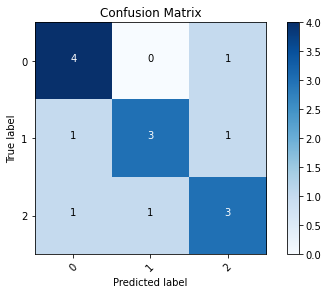

In [81]:
#Train the model for more epochs to see better results
cm_plot_labels = ['0','1','2']

plot_confusion_matrix(cm=cm, classes=cm_plot_labels, title = 'Confusion Matrix')

Figure 6. Confusion  Matrix when all except the last 40 layers are freeze. Accuracy test set = 73%.

## Modified Model (-30)

In [82]:
x = mobile.layers[-6].output
output = Dense(units=3, activation = 'softmax')(x)

model = Model(inputs=mobile.input,outputs=output)

for layer in model.layers[:-30]:
    layer.trainable= False

## Training the Model (-30)

In [83]:
model.compile(optimizer=Adam(lr=0.0001),loss='categorical_crossentropy',metrics=['accuracy'])
model.fit(x=train_batches, validation_data=valid_batches, epochs=20,verbose=2)

Epoch 1/20
53/53 - 24s - loss: 0.2650 - accuracy: 0.8933 - val_loss: 1.4970 - val_accuracy: 0.6517
Epoch 2/20
53/53 - 23s - loss: 0.0169 - accuracy: 1.0000 - val_loss: 0.9602 - val_accuracy: 0.7528
Epoch 3/20
53/53 - 23s - loss: 0.0116 - accuracy: 1.0000 - val_loss: 0.6956 - val_accuracy: 0.7865
Epoch 4/20
53/53 - 22s - loss: 0.0226 - accuracy: 0.9962 - val_loss: 0.6763 - val_accuracy: 0.7753
Epoch 5/20
53/53 - 22s - loss: 0.0065 - accuracy: 0.9981 - val_loss: 0.8637 - val_accuracy: 0.7865
Epoch 6/20
53/53 - 22s - loss: 0.0112 - accuracy: 0.9962 - val_loss: 0.8850 - val_accuracy: 0.7865
Epoch 7/20
53/53 - 22s - loss: 0.0107 - accuracy: 1.0000 - val_loss: 0.7573 - val_accuracy: 0.7978
Epoch 8/20
53/53 - 21s - loss: 0.0038 - accuracy: 1.0000 - val_loss: 0.6279 - val_accuracy: 0.8090
Epoch 9/20
53/53 - 22s - loss: 0.0046 - accuracy: 1.0000 - val_loss: 0.5957 - val_accuracy: 0.8090
Epoch 10/20
53/53 - 22s - loss: 0.0032 - accuracy: 1.0000 - val_loss: 0.6241 - val_accuracy: 0.8090
Epoch 11/

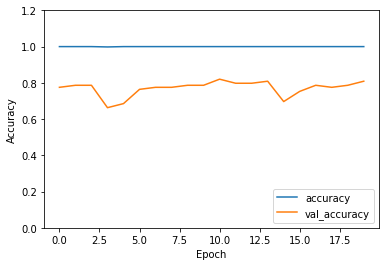

In [84]:
# We got an accuracy of 98.48% and an accuracy of 83.15%.
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1.2])
plt.legend(loc='lower right')

Figure 7. Accuracy vs. Epoch showing how the accuracy and validation accuracy changes with the epoch when all layers are freeze except the last 30 layers.

## Predict Sedimentary Structures (-30)

Confusion matrix, without normalization
[[5 0 0]
 [1 3 1]
 [0 1 4]]


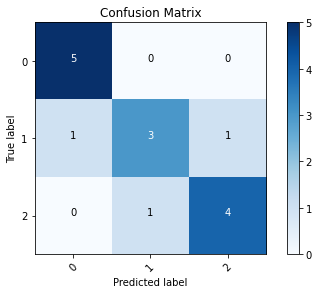

In [86]:
test_labels = test_batches.classes
predictions = model.predict(x=test_batches, verbose = 0)
cm = confusion_matrix(y_true=test_labels, y_pred=predictions.argmax(axis=1))
plot_confusion_matrix(cm=cm, classes=cm_plot_labels, title = 'Confusion Matrix')

Figure 8. Confusion  Matrix when all except the last 30 layers are freeze. Accuracy test set = 80%

## Modified Model (-20)

In [87]:
x = mobile.layers[-6].output
output = Dense(units=3, activation = 'softmax')(x)

model = Model(inputs=mobile.input,outputs=output)

for layer in model.layers[:-20]:
    layer.trainable= False

## Training the Model (-20)

In [88]:
model.compile(optimizer=Adam(lr=0.0001),loss='categorical_crossentropy',metrics=['accuracy'])
history = model.fit(x=train_batches, validation_data=valid_batches, epochs=20,verbose=2)

Epoch 1/20
53/53 - 24s - loss: 0.2736 - accuracy: 0.8990 - val_loss: 1.5278 - val_accuracy: 0.6404
Epoch 2/20
53/53 - 22s - loss: 0.0237 - accuracy: 1.0000 - val_loss: 0.9414 - val_accuracy: 0.7303
Epoch 3/20
53/53 - 22s - loss: 0.0200 - accuracy: 0.9962 - val_loss: 0.8284 - val_accuracy: 0.7640
Epoch 4/20
53/53 - 22s - loss: 0.0064 - accuracy: 1.0000 - val_loss: 0.7330 - val_accuracy: 0.7978
Epoch 5/20
53/53 - 22s - loss: 0.0095 - accuracy: 1.0000 - val_loss: 0.6918 - val_accuracy: 0.7978
Epoch 6/20
53/53 - 22s - loss: 0.0072 - accuracy: 1.0000 - val_loss: 0.6659 - val_accuracy: 0.7865
Epoch 7/20
53/53 - 22s - loss: 0.0049 - accuracy: 1.0000 - val_loss: 0.6658 - val_accuracy: 0.7865
Epoch 8/20
53/53 - 491s - loss: 0.0027 - accuracy: 1.0000 - val_loss: 0.6494 - val_accuracy: 0.8202
Epoch 9/20
53/53 - 22s - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.6462 - val_accuracy: 0.8090
Epoch 10/20
53/53 - 22s - loss: 0.0074 - accuracy: 1.0000 - val_loss: 0.6636 - val_accuracy: 0.7865
Epoch 11

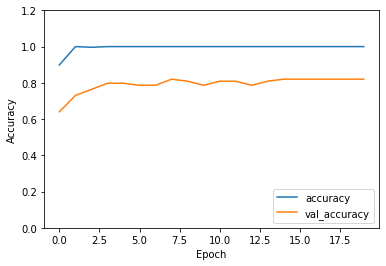

In [89]:
# We got an accuracy of 1 and a val_accuracy of 0.82

plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1.2])
plt.legend(loc='lower right')

Figure 9. Accuracy vs. Epoch showing how the accuracy and validation accuracy changes with the epoch when all layers are freeze except the last 20 layers.

## Predict Sedimentary Structures (-20)

Confusion matrix, without normalization
[[3 1 1]
 [0 3 2]
 [1 1 3]]


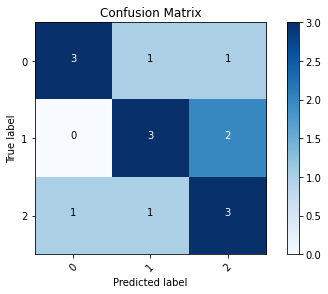

In [91]:
test_labels = test_batches.classes
predictions = model.predict(x=test_batches, verbose = 0)
cm = confusion_matrix(y_true=test_labels, y_pred=predictions.argmax(axis=1))
plot_confusion_matrix(cm=cm, classes=cm_plot_labels, title = 'Confusion Matrix')

Figure 10. Confusion  Matrix when all except the last 20 layers are freeze. Accuracy test set = 73.3%

## Discussion

Using a MobileNet to train the model and adding more images to the data set increases in 30% the accuracy of the validation set. Previously a CNN designed by the author to solve this problem had an accuracy of 50% for the validation set. This number increases to 83% using transfer learning, freezing all except the last 30 layers of MobileNet and running the model in 20 epochs. On new data (training set), the accuracy was 80%. The accuracy of the validation and training set reduces when all except the last 20 and 40 layers of MobilNet are freeze. The model presents overfitting as the accuracy for the training set is 100%. The overfitting could be improved if we add more data, tune more the hyperparameters, or use cross-validation.  This technique could improve the task of interpreting the sedimentary structures in the field and millions of pictures taken every day by Mars' rovers. Besides, as Pires de Lima et al.(2019) mentioned, ML can help to maintain consistency and reduce bias in interpretations.  ML could provide a tool to describe less common observations and data variations, such as overlook sedimentary structures. To avoid labeling mistakes, experts from different Universities and Organizations could help labeling the data.

## Conclusions

Pre-trained Convolutional Neural Networks and transfer learning can be used to improve data management and interpretation in different segments of the geologic community. This method was effectively used in predicting sedimentary structures, though further work needs to be done. The author suggests that experts of different organizations labeled the data, to create a universal model that helps avoid bias in interpretations.

## Bibliography

A, K., Jayadevaprakash, N., Yao, B., & Li, F. (2011). Novel Dataset for Fine-Grained Image Categorization: Stanford Dogs. Novel Dataset for Fine-Grained Image Categorization: Stanford Dogs. Published. https://people.csail.mit.edu/khosla/papers/fgvc2011.pdf
<br>
Alnakli, M. (2018, November 3). Training and Deploying A Deep Learning Model in Keras MobileNet V2 and Heroku: A Step-by-Step Tutorial Part 1. Medium. https://medium.com/hackernoon/tf-serving-keras-mobilenetv2-632b8d92983c
<br>
Anderson, R., Bridges, J. C., Williams, A., Edgar, L., Ollila, A., Williams, J., Nachon, M., Mangold, N., Fisk, M., Schieber, J., Gupta, S., Dromart, G., Wiens, R., Le Mouélic, S., Forni, O., Lanza, N., Mezzacappa, A., Sautter, V., Blaney, D., … Vaniman, D. (2015). ChemCam results from the Shaler outcrop in Gale crater, Mars. Icarus, 249, 2–21. https://doi.org/10.1016/j.icarus.2014.07.025
<br>
Brownlee, J. (2019, July 5). How to Configure Image Data Augmentation in Keras. Machine Learning Mastery. https://machinelearningmastery.com/how-to-configure-image-data-augmentation-when-training-deep-learning-neural-networks/
<br>
Convolutional Neural Network. (n.d.). Tensor Flow. Retrieved December 2, 2020, from https://www.tensorflow.org/tutorials/images/cnn
<br>
DeepLizard, (2020, September 27). Retrieved May 5, 2021, from https://www.youtube.com/watch?v=Zrt76AIbeh4
<br>
DeVries, P. M. R., Viégas, F., Wattenberg, M., & Meade, B. J. (2018). Deep learning of aftershock patterns following large earthquakes. Nature, 560(7720), 632–634. https://doi.org/10.1038/s41586-018-0438-y
<br>
Edgar, L. A., Gupta, S., Rubin, D. M., Lewis, K. W., Kocurek, G. A., Anderson, R. B., Bell, J. F., Dromart, G., 
<br>
Edgett, K. S., Grotzinger, J. P., Hardgrove, C., Kah, L. C., Leveille, R., Malin, M. C., Mangold, N., Milliken, R. E., 
<br>
Minitti, M., Palucis, M., Rice, M., … Williams, A. J. (2017). Shaler: in situ analysis of a fluvial sedimentary deposit on Mars. Sedimentology, 65(1), 96–122. https://doi.org/10.1111/sed.12370
<br>
Nair, A. (2021, February 15). A practical Guide To Implement Transfer Learning: MobileNet V2 In TensorFlow. Retrieved February 2, 2021, from https://analyticsindiamag.com/a-practical-guide-to-implement-transfer-learning-in-tensorflow/#:~:text=Transfer learning is simply the,“
<br>
Hall, B. (2016). Facies classification using machine learning. The Leading Edge, 35(10), 906–909. https://doi.org/10.1190/tle35100906.1
<br>
Home. (n.d.). NASA’s Mars Exploration Program. Retrieved December 13, 2020, from https://mars.nasa.gov/msl/home/
<br>
Howard, A. G., Zhu, M., Chen, B., Kalenichenko, D., Wang, W., Weyand, T., Andreetto, M., & Adam, H. (2017). MobileNets: Efficient Convolutional Neural Networks for Mobile Vision Applications. Computer Vision and Pattern Recognition. Published. https://arxiv.org/abs/1704.04861
<br>
Image classification. (n.d.). Tensor Flow. Retrieved December 10, 2020, from https://www.tensorflow.org/tutorials/images/classification
<br>
Lima,R.,Bonar,A.,Duarte,D.,Marfurt,K.,Nicholson.,C.(2019)Deep convolutional neural
networks as a geological image classification tool
<br>
sentdex. (2018, September 18). Loading in your own data - Deep Learning basics with Python, TensorFlow and Keras p.2 [Video]. YouTube. https://www.youtube.com/watch?v=j-3vuBynnOE
<br>
Real Python. (2020, November 17). Split Your Dataset With scikit-learn's train_test_split(). https://realpython.com/train-test-split-python-data/#prerequisites-for-using-train_test_split